
> Disusun oleh **Gabriel Jonathan** \\
> *https://jrtkst.github.io*

# **1. Mengenal PINN**


PINN (*Physics Informed Neural Network*) adalah ...

PINN adalah salah satu **tools** yang dapat membantu kita menyelesaikan suatu permasalahan dalam pemodelan matematika yang melibatkan persamaan diferensial.


# **2. Studi Kasus : Persamaan Burgers**


\begin{equation*}
\dfrac{\partial u}{\partial t} + u\dfrac{\partial u}{\partial x} = 0
\end{equation*}

pada domain $(x,t)\in [0, L] \times [0, T]$ dengan syarat awal $u(x,0)=f(x)$.

## **2.1. Formulasi Loss Function**

**Loss Function Syarat Awal**
>    Definisikan
    \begin{equation*}
        \mathcal{L}_a = \dfrac{1}{N_a}\sum_{i=1}^{N_a}\lvert \hat{u}(x_i^a, 0) - f(x_i^a)\rvert^2
    \end{equation*}


**Loss Function PDP**
> Dengan $g(x,t) = u_t + uu_x$, definisikan:
    \begin{equation*}
        \mathcal{L}_p = \dfrac{1}{N_p}\sum_{i=1}^{N_p}\lvert g(x_i^p, t_i^p)\rvert^2
    \end{equation*}


## **2.2. Arsitektur PINN**

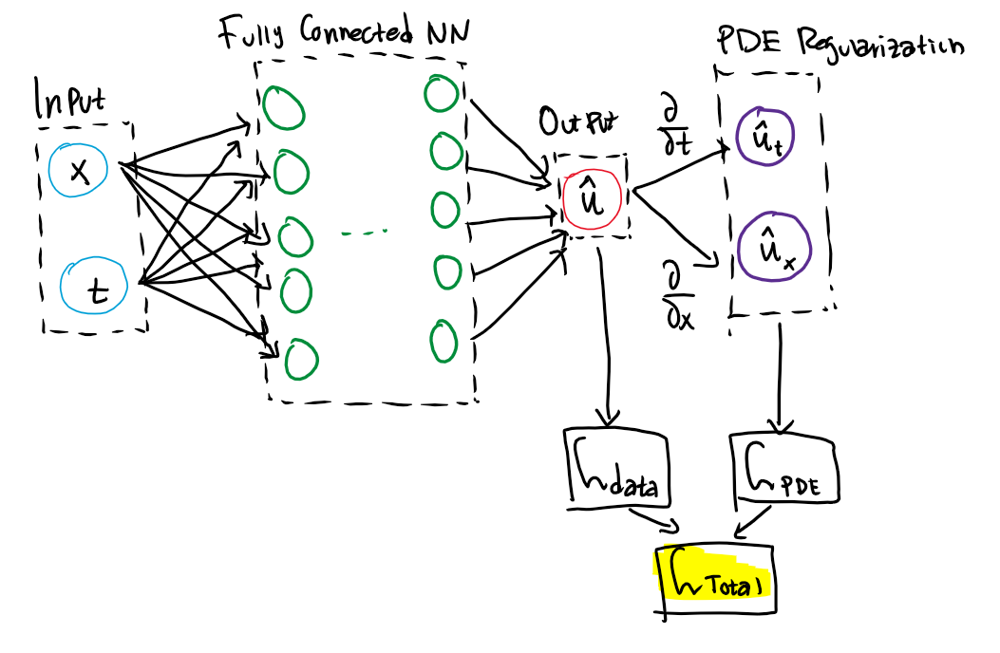

# **3. Program**

## **3.1. Membangun Neural Network**

In [1]:
# Package yang diperlukan
import numpy as np
import random
import matplotlib.pyplot as plt
import time

import torch
import torch.nn as nn               # neural networks
import torch.optim as optim         # optimizer
import torch.autograd as autograd   # automatic gradient


#PyTorch RNG seed
torch.manual_seed(2904)

# NumPy RNG seed
np.random.seed(2904)

In [2]:
class PINN_Burgers(nn.Module):
    def __init__(self, layers, f):
        super().__init__()
        'Linear layers'
        self.linears = nn.ModuleList([nn.Linear(layers[i], layers[i+1]) for i in range(len(layers)-1)])
        'Activation function'
        self.tanh = nn.Tanh()
        'Loss function'
        self.MSE = nn.MSELoss()
        'Initial Condition Function'
        self.f = f

    'Forward pass'
    def forward(self, x, t):
        xt = torch.cat((x, t), 1)
        if torch.is_tensor(xt) != True:
            xt = torch.from_numpy(xt)
        a = xt.float()
        for i in range(len(layers) - 2):
            z = self.linears[i](a)
            a = self.tanh(z)
        a = self.linears[-1](a)
        return a

    'Loss functions'
    # Data Loss
    def loss_IC(self, x_a):
        u_hat = self.forward(x_a, torch.zeros_like(x_a))
        return self.MSE(u_hat, self.f(x_a))

    def g(self, x, t):
        u_hat = self.forward(x, t)
        u_t = torch.autograd.grad(u_hat, t, torch.ones_like(u_hat), create_graph=True)[0]
        u_x = torch.autograd.grad(u_hat, x, torch.ones_like(u_hat), create_graph=True)[0]
        g_hat = u_t + u_hat * u_x
        return g_hat

    # PDE Loss
    def loss_PDE(self, x, t):
        x.requires_grad = True
        t.requires_grad = True
        g_hat = self.g(x, t)
        return self.MSE(g_hat, torch.zeros_like(g_hat))

    # Total Loss
    def loss(self, x_a, x_p, t_p):
        loss_IC = self.loss_IC(x_a)
        loss_PDE = self.loss_PDE(x_p, t_p)
        return loss_IC + loss_PDE

## **3.1. Training Model**

Misalkan $L = 10$, $T = 10$, dan $f(x) = \exp^{-(x-5)^2}$

In [3]:
# Define the neural network
layers = [2, 20, 20, 20, 20, 20, 20, 20, 20, 1] # neurons on on each layers, input : [x, t]
f = lambda x : np.exp(-(x - 5)**2)

NN_Burgers = PINN_Burgers(layers, f)
print(NN_Burgers)

PINN_Burgers(
  (linears): ModuleList(
    (0): Linear(in_features=2, out_features=20, bias=True)
    (1-7): 7 x Linear(in_features=20, out_features=20, bias=True)
    (8): Linear(in_features=20, out_features=1, bias=True)
  )
  (tanh): Tanh()
  (MSE): MSELoss()
)


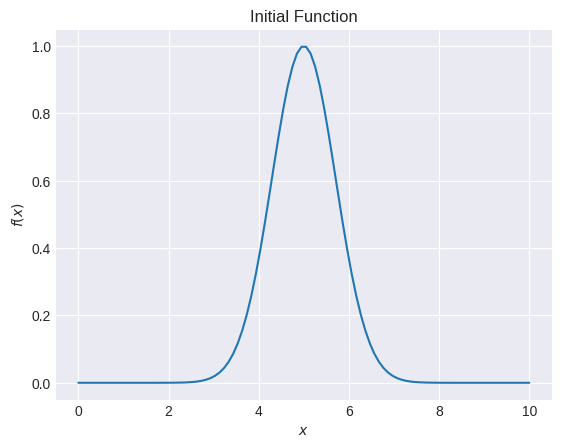

In [4]:
# Initial Condition
plt.rcParams['figure.dpi'] = 100
plt.style.use('seaborn-v0_8-darkgrid')
xs1 = np.linspace(0, 10, 100)
plt.xlabel('$x$')
plt.ylabel('$f(x)$')
plt.plot(xs1, f(xs1))
plt.title('Initial Function')
plt.show()

Training Data Size
Data Loss (x, t) :  torch.Size([200, 1]) torch.Size([200, 1])
PDE Loss (x, t)  :  torch.Size([6200, 1]) torch.Size([6200, 1])


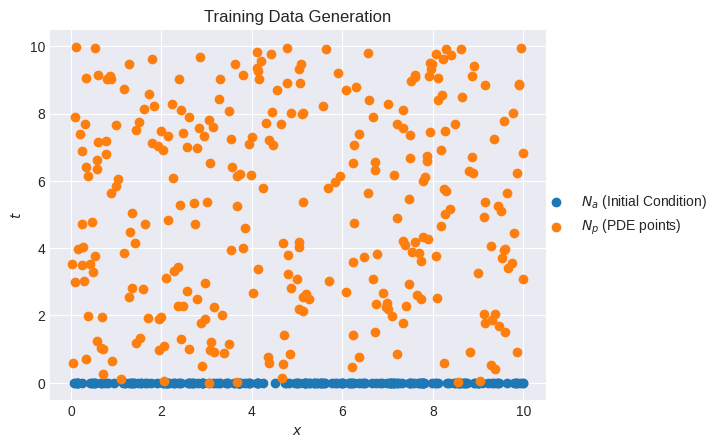

In [5]:
# Define training data
N_a = 200          # number of points on boundary
N_p = 6000          # number of collocation points for PDE loss
# Generate training data
Lx = 10
T = 10
x_a = torch.rand(N_a, 1) * Lx
t_a = torch.zeros_like(x_a)
x_p = torch.cat((x_a, torch.rand(N_p, 1) * Lx), 0)
t_p = torch.cat((t_a, torch.rand(N_p, 1) * T), 0)
print('Training Data Size')
print('Data Loss (x, t) : ', x_a.shape, t_a.shape)
print('PDE Loss (x, t)  : ', x_p.shape, t_p.shape)

plt.scatter(x_a, np.zeros_like(x_a))
plt.scatter(x_p[200:500], t_p[200:500])

plt.legend(['$N_a$ (Initial Condition)', '$N_p$ (PDE points)'], loc='center right', bbox_to_anchor=(1.35, 0.5))
plt.xlabel('$x$')
plt.ylabel('$t$')
plt.title('Training Data Generation')
plt.show()

In [6]:
# Training
lr_Adam = 1e-3       # learning rate
opt_Adam = optim.Adam(NN_Burgers.parameters(), lr=lr_Adam)
epochs_Adam = 10000
iter_arr = []
PDE_losses = []
IC_losses = []
start_time = time.time()
print('############# PINN Burgers Training | Adam Optimizer #############')
for i in range(epochs_Adam):
    if i == 0:
        print("#Epoch", '\t',  'IC Loss', '\t', 'PDE Loss')
    opt_Adam.zero_grad()
    loss = NN_Burgers.loss(x_a, x_p, t_p)
    loss.backward()
    opt_Adam.step()
    if (i==0) or (i+1)%(epochs_Adam//20)==0:
        loss_IC = NN_Burgers.loss_IC(x_a).item()
        loss_PDE = NN_Burgers.loss_PDE(x_p, t_p).item()
        iter_arr.append(i)
        PDE_losses.append(loss_PDE)
        IC_losses.append(loss_IC)
        print(i+1, '\t', "{:.7e}".format(loss_IC), '\t', "{:.7e}".format(loss_PDE))
end_time = time.time()

print('Training Time : {:.2f} minute(s)'.format((end_time - start_time)/60))

############# PINN Burgers Training | Adam Optimizer #############
#Epoch 	 IC Loss 	 PDE Loss
1 	 9.1758929e-02 	 8.7235964e-07
500 	 3.8952753e-04 	 1.4943674e-03
1000 	 1.7614508e-04 	 1.5049756e-03
1500 	 2.6526058e-04 	 1.3644710e-03
2000 	 4.4339578e-04 	 1.1863247e-03
2500 	 9.2501556e-05 	 1.0816379e-03
3000 	 5.2882759e-05 	 9.7761606e-04
3500 	 5.7306504e-05 	 9.7180461e-04
4000 	 4.6364701e-05 	 9.4127760e-04
4500 	 4.8614940e-05 	 9.2711172e-04
5000 	 7.3065625e-05 	 9.2100195e-04
5500 	 5.8547710e-05 	 8.6525065e-04
6000 	 1.9602725e-04 	 8.4280974e-04
6500 	 1.7493020e-04 	 8.4631250e-04
7000 	 5.9755934e-05 	 8.5781288e-04
7500 	 5.4900134e-05 	 8.4543391e-04
8000 	 4.5466553e-05 	 8.3918450e-04
8500 	 1.1889188e-04 	 8.8899292e-04
9000 	 5.3102820e-05 	 8.1268663e-04
9500 	 4.9198774e-05 	 8.1173680e-04
10000 	 4.8158858e-05 	 8.1327459e-04
Training Time : 5.55 minute(s)


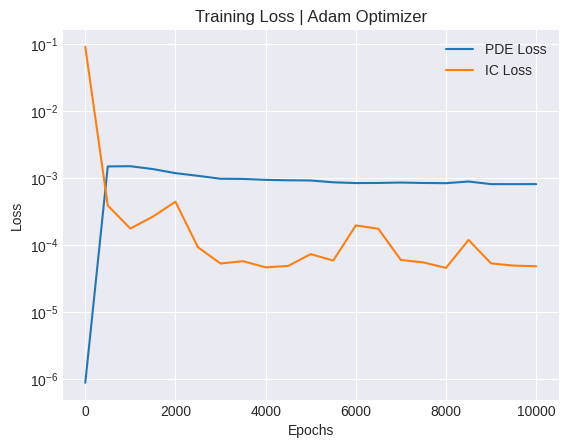

In [7]:
# Plot Losses
plt.plot(iter_arr, PDE_losses)
plt.plot(iter_arr, IC_losses)
plt.yscale('log')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss | Adam Optimizer')
plt.legend(['PDE Loss', 'IC Loss'])
plt.show()

Perhatikan bahwa dalam bebeapa iterasi akhir, nilai loss tidak berkurang secara signifikan.

`Adam` adalah optimizer orde satu. Artinya, performa `Adam` tidak terlalu presisi dan akurat dalam menemukan titik optimal. Tetapi `Adam` bekerja dengan cepat.

Penggunaan `Adam` sebagai optimizer pertama membantu kita untuk melacak atau mendekati titik optimal sedekat mungkin, tetapi tidak bisa menemukan titik optimal secara eksak.

Untuk menentukan titik optimal secara lebih baik, proses training dilanjutkan menggunakan optimizer yang tingkat akurasinya lebih baik. Dalam kasus ini, digunakan suatu optimizer orde dua yaitu `L-BFGS`.

In [8]:
# Training
lr_LBFGS = 1e-3       # learning rate
opt_LBFGS = optim.LBFGS(NN_Burgers.parameters(), lr=lr_LBFGS,
                        max_iter = 10,
                        tolerance_grad = 1e-11,
                        tolerance_change = 1e-11,
                        line_search_fn = 'strong_wolfe')
epochs_LBFGS = 500
start_time = time.time()
print('############# PINN Burgers Training | LBFGS Optimizer #############')
for i in range(epochs_LBFGS):
    if i == 0:
        print("#Epoch", '\t',  'IC Loss', '\t', 'PDE Loss')
    def closure():
        opt_LBFGS.zero_grad()
        loss = NN_Burgers.loss(x_a, x_p, t_p)
        loss.backward()
        return loss
    opt_LBFGS.step(closure)
    if (i==0) or (i+1)%(epochs_LBFGS//20)==0:
        loss_IC = NN_Burgers.loss_IC(x_a).item()
        loss_PDE = NN_Burgers.loss_PDE(x_p, t_p).item()
        iter_arr.append(epochs_Adam + i)
        PDE_losses.append(loss_PDE)
        IC_losses.append(loss_IC)
        print(i+1, '\t', "{:.7e}".format(loss_IC), '\t', "{:.7e}".format(loss_PDE))
end_time = time.time()

print('Training Time : {:.2f} minute(s)'.format((end_time - start_time)/60))

############# PINN Burgers Training | LBFGS Optimizer #############
#Epoch 	 IC Loss 	 PDE Loss
1 	 3.2737691e-05 	 7.8489049e-04
25 	 3.1823722e-05 	 7.8279298e-04
50 	 3.1823722e-05 	 7.8279298e-04
75 	 3.1823722e-05 	 7.8279298e-04
100 	 3.1823722e-05 	 7.8279298e-04
125 	 3.1823722e-05 	 7.8279298e-04
150 	 3.1823722e-05 	 7.8279298e-04
175 	 3.1823722e-05 	 7.8279298e-04
200 	 3.1823722e-05 	 7.8279298e-04
225 	 3.1823722e-05 	 7.8279298e-04
250 	 3.1823722e-05 	 7.8279298e-04
275 	 3.1823722e-05 	 7.8279298e-04
300 	 3.1823722e-05 	 7.8279298e-04
325 	 3.1823722e-05 	 7.8279298e-04
350 	 3.1823722e-05 	 7.8279298e-04
375 	 3.1823722e-05 	 7.8279298e-04
400 	 3.1823722e-05 	 7.8279298e-04
425 	 3.1823722e-05 	 7.8279298e-04
450 	 3.1823722e-05 	 7.8279298e-04
475 	 3.1823722e-05 	 7.8279298e-04
500 	 3.1823722e-05 	 7.8279298e-04
Training Time : 1.12 minute(s)


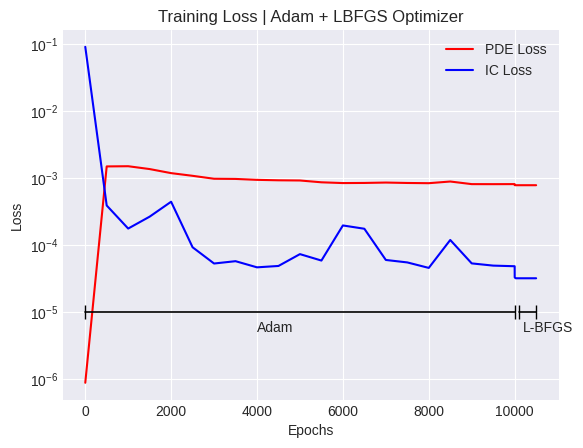

In [9]:
# Plot Losses
plt.plot(iter_arr, PDE_losses, 'r-')
plt.plot(iter_arr, IC_losses, 'b-')
plt.yscale('log')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss | Adam + LBFGS Optimizer')
plt.legend(['PDE Loss', 'IC Loss'])


plt.plot([0, epochs_Adam], [1e-5, 1e-5], 'k|-', linewidth=1.2, markersize=10)
plt.text(epochs_Adam*0.4, 1e-5*0.5, 'Adam')
plt.plot([epochs_Adam + 100, epochs_Adam + epochs_LBFGS], [1e-5, 1e-5], 'k|-', linewidth=1.2, markersize=10)
plt.text(epochs_Adam + epochs_LBFGS*0.4, 1e-5*0.5, 'L-BFGS')
plt.show()

## **3.2. Hasil**

In [10]:
# Generate data untuk testing
Nx = 501
Nt = 501
x_test = torch.linspace(0, Lx, Nx)
t_test = torch.linspace(0, T, Nt)

# Stacking
x_grid, t_grid = torch.meshgrid(x_test, t_test, indexing='xy')
xt_test = torch.hstack((x_grid.flatten().view(-1, 1), t_grid.flatten().view(-1, 1)))

# Generate prediction pada koordinat x_test, t_test
u_hat = NN_Burgers.forward(xt_test[:, [0]], xt_test[:, [1]]).detach().reshape(x_grid.shape)

# Convert ke numpy untuk plotting
x_grid = x_grid.numpy()
t_grid = t_grid.numpy()
u_hat = u_hat.numpy()

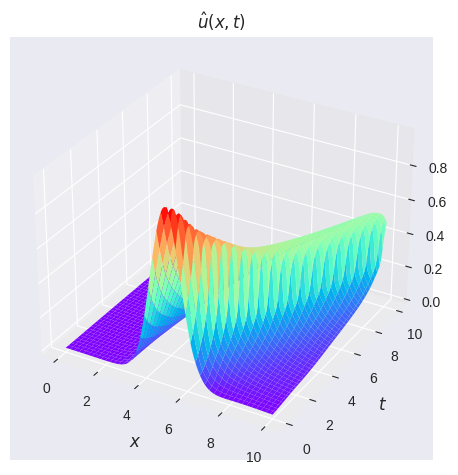

In [11]:
plt.rcParams['figure.dpi'] = 100
ax = plt.axes(projection='3d')
ax.plot_surface(x_grid, t_grid, u_hat, cmap='rainbow')
ax.set(xlabel=r"$x$", ylabel=r"$t$", title=r"$\hat{u}(x, t)$")
ax.title.set_fontsize(12)
ax.xaxis.label.set_fontsize(12)
ax.yaxis.label.set_fontsize(12)
plt.tight_layout()
plt.show()

In [36]:
%matplotlib inline
from matplotlib import rc
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
rc('animation', html='jshtml')


fig, ax = plt.subplots(1, 1)
line, = ax.plot(x_test, u_hat[0, :])

ax.grid('on')
ax.set_xlabel('$x$', fontsize=14)
ax.set_ylabel('$\hat{u}(x, t)$', fontsize=14)
ax.set_title('Burgers Animation', fontsize=14)

plt.close()
def animate(i):
    line.set_data(x_test, u_hat[i, :])
    t_i = (i)*(T/Nt)
    ax.set_ylabel('$\hat{u}(x, %.4f)$' % (t_i), fontsize=14)
    return line


ani = FuncAnimation(fig, animate, frames=range(0, Nt , 1), interval=20, blit=False)
ani


In [ ]:
# # Opsi lain untuk save animasi dalam format .gif | Uncomment section ini

# import matplotlib.animation as animation
# from matplotlib.animation import PillowWriter
# fig, ax = plt.subplots(1, 1)
# plt.rcParams["figure.figsize"] = (8, 6)

# def animate(i):
#     ax.clear()
#     ax.plot(x_test, u_hat[i, :], 'b-', linewidth=3)
#     ax.set_xlim([0, Lx])
#     ax.set_ylim([0, 1])
#     t_i = (i + 1)*(T/Nt)
#     ax.set_ylabel('$\hat{u}(x, %.4f)$' % (t_i), fontsize=15)
#     ax.set_xlabel('x', fontsize=15)
#     ax.grid('on')
#     plt.tight_layout()
# ani = animation.FuncAnimation(fig, animate, frames=Nt, interval=0.1, repeat=True)
# ani.save("burgers_animation.gif", dpi=100, writer=PillowWriter(fps=60))
# plt.close()

# Exercise

## **Soal 1**
Pandang persamaan diferensial untuk model traffic flow berikut:

\begin{equation*}
\dfrac{\partial n}{\partial t} + V_f\left(1 - \dfrac{2n}{n_{max}}\right)\dfrac{\partial n}{\partial x} = 0
\end{equation*}

pada domain $(x,t)\in [0, L] \times [0, T]$ dengan syarat awal $n(x,0)=n_0(x)$ dan
*   $V_f$ : free flow velocity (km/jam)
*   $n_{max}$ : jam/maximum density pada segmen jalan (mobil/km)



Tunjukkan bahwa bentuk PDP diatas dapat disederhanakan menjadi suatu bentuk persamaan Burgers.

## **Soal 2**
Bangun suatu class neural network `PINN_Traffic_Flow` seperti pada contoh diatas untuk menyelesaikan persamaan diferensial pada Soal 1.

Setelah Anda melakukan iterasi dengan optimizer `Adam`, gunakan optimizer `L-BFGS` untuk melanjutkan proses training.


## **Soal 3**
Salah satu isu yang paling sering dijumpai dalam aplikasi PINN adalah loss function yang tidak seimbang antara satu sama lain. Nilai loss yang tidak seimbang mengakibatkan neural network yang cenderung meminimalkan salah satu loss function saja dan membiarkan yang lainnya.

Sebagai mitigasi, Anda dapat mendefinisikan loss function sebagai berikut:

\begin{equation*}
L_{Total} = \lambda_{PDE}L_{PDE} + \lambda_{IC}L_{IC}
\end{equation*}
dengan koefisien $\lambda_{PDE},\lambda_{IC}\in \mathbb{R}_{\geq 0}$

Nilai $\lambda$ dapat secara manual melalui eksperimen dengan memperhatikan perkembangan nilai loss nya, untuk memastikan bahwa kedua loss function nilainya selalu seimbang.

Anda juga dapat menggunakan metode **adaptive loss balancing** secara iteratif (Material : https://arxiv.org/abs/2110.09813) untuk menentukan nilai $\lambda$.


Bangun suatu neural network dengan loss function yang telah dimodifikasi untuk menyelesaikan PDP pada Soal 1.